In [1]:
!pip install spotipy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 255.6/255.6 kB 5.8 MB/s eta 0:00:00


In [2]:
!pip install yellowbrick

# Importing Libraries

In [3]:
# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder, StandardScaler
from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans
import plotly.express as px
from sklearn.decomposition import PCA
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict
from scipy.spatial.distance import cdist
import ast
import warnings

warnings.filterwarnings("ignore")

# Loading DataSet

In [4]:
# Load dataset
path = '/content/drive/MyDrive/Projects/Spotify recommendation System/archive/spotify_data_12_20_2023.csv'
df = pd.read_csv(path, low_memory=False)

# Data Cleaning

In [5]:
# Selecting relevant features
df = df[['track_name', 'artists', 'artist_genres', 'explicit','album_name', 'release_year', 'danceability',
           'energy', 'key','loudness', 'mode', 'speechiness', 'acousticness',
           'instrumentalness', 'liveness', 'valence', 'tempo', 'time_signature']]


In [6]:
# Removing symbols from artists names
df['artists'] = df['artists'].str.replace(r"['\[\]]", '', regex=True)

In [7]:
# Processing artists genres to fit the purpose of the project
list_of_lists = [ast.literal_eval(s) for s in df['artist_genres']]
df['artist_genres'] = [sublist[0] if sublist else None for sublist in list_of_lists]
df['artist_genres'].fillna("unknown", inplace=True)

# Renaming column
df.rename(columns={'track_name':'name'}, inplace=True)

In [8]:
# Summary of DataFrame information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 375141 entries, 0 to 375140
Data columns (total 18 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   name              375136 non-null  object 
 1   artists           375141 non-null  object 
 2   artist_genres     375141 non-null  object 
 3   explicit          375131 non-null  object 
 4   album_name        375140 non-null  object 
 5   release_year      375119 non-null  float64
 6   danceability      374364 non-null  float64
 7   energy            374364 non-null  float64
 8   key               374364 non-null  float64
 9   loudness          374364 non-null  float64
 10  mode              374364 non-null  float64
 11  speechiness       374364 non-null  float64
 12  acousticness      374364 non-null  float64
 13  instrumentalness  374364 non-null  float64
 14  liveness          374364 non-null  float64
 15  valence           374364 non-null  float64
 16  tempo             37

In [9]:
# Number of unique values in each column
print('\nNumber of unique values in each column')
for i in df.columns:
    print(f'{i} - {df[i].nunique()}')

# Number of missing values in each column
print('\nNumber of missing values in each column\n', df.isnull().sum())

# Number of duplicated rows
print('\nNumber of duplicated rows\n', df.duplicated().sum())


Number of unique values in each column
name - 275523
artists - 66001
artist_genres - 3009
explicit - 2
album_name - 61467
release_year - 85
danceability - 1327
energy - 2918
key - 12
loudness - 32916
mode - 2
speechiness - 1653
acousticness - 5242
instrumentalness - 5402
liveness - 1769
valence - 2043
tempo - 101940
time_signature - 5

Number of missing values in each column
 name                  5
artists               0
artist_genres         0
explicit             10
album_name            1
release_year         22
danceability        777
energy              777
key                 777
loudness            777
mode                777
speechiness         777
acousticness        777
instrumentalness    777
liveness            777
valence             777
tempo               777
time_signature      777
dtype: int64

Number of duplicated rows
 0


In [10]:
# Dropping rows with empty values
df = df.dropna()
print('Length of the dataset:', len(df))

# Setting value type to integer
df['explicit'] = df['explicit'].astype(int)
df['release_year'] = df['release_year'].astype(int)

Length of the dataset: 374327


In [11]:
# Applying Label Encoder to artist genre values
label_encoder = LabelEncoder()
df['artist_genres_encoded'] = label_encoder.fit_transform(df['artist_genres'])

In [12]:
df.describe()

# Resetting dataframe index
df.reset_index(drop=True, inplace=True)

# Exploratory Data Analysis

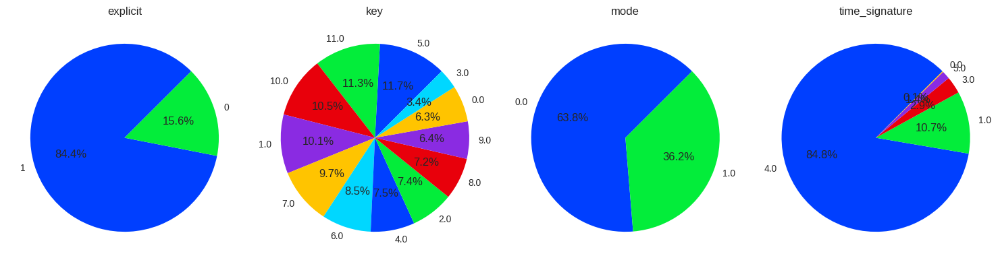

In [13]:
# Exploratory Data Analysis (EDA)

plt.style.use('seaborn-v0_8-bright')
colors = sns.color_palette('bright')

fig, axes = plt.subplots(1, 4, figsize=(15, 4))  # 1 row, 4 columns

for i, name in enumerate(['explicit', 'key', 'mode', 'time_signature']):
    axes[i].pie(df[name].value_counts(), labels=df[name].unique(), autopct='%1.1f%%', startangle=45)
    axes[i].set_title(f'{name}')

# Display the plot
plt.tight_layout()
plt.show()

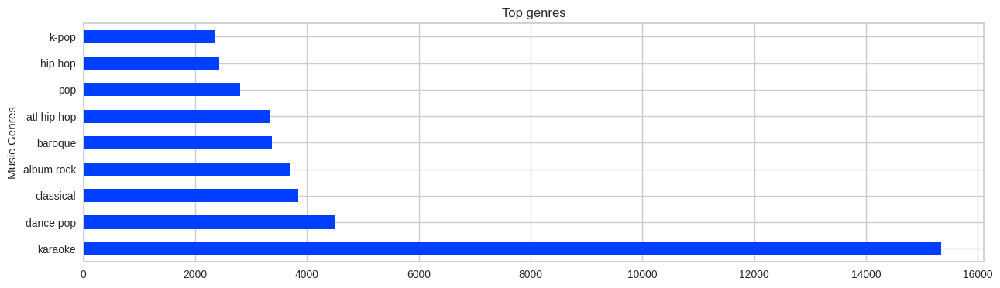

In [14]:
# Top 10 genres based on frequency
plt.figure(figsize=(15, 4))
df['artist_genres'].value_counts().head(10).iloc[1:].plot(kind='barh',title='Top genres')
plt.ylabel('Music Genres')
plt.grid(True)
plt.show()

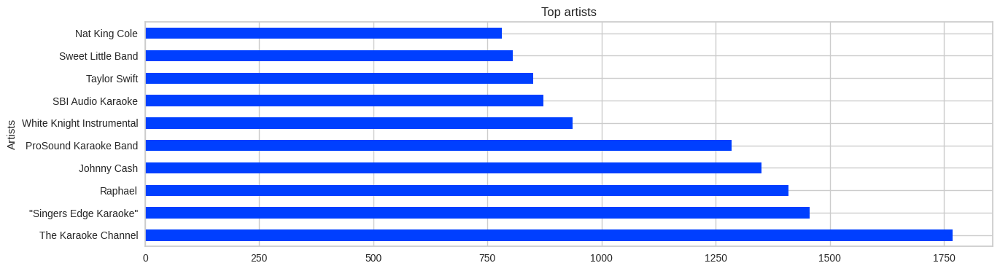

In [15]:
# Top 10 artists based on frequency
plt.figure(figsize=(15, 4))
df['artists'].value_counts().head(10).plot(kind='barh',title='Top artists')
plt.ylabel('Artists')
plt.grid(True)
plt.show()

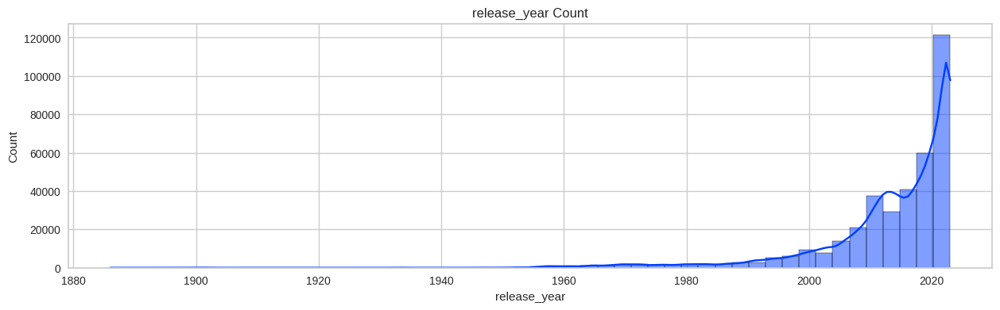

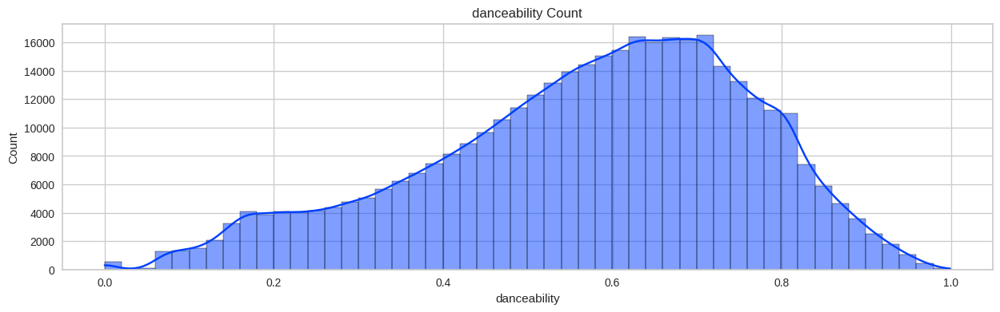

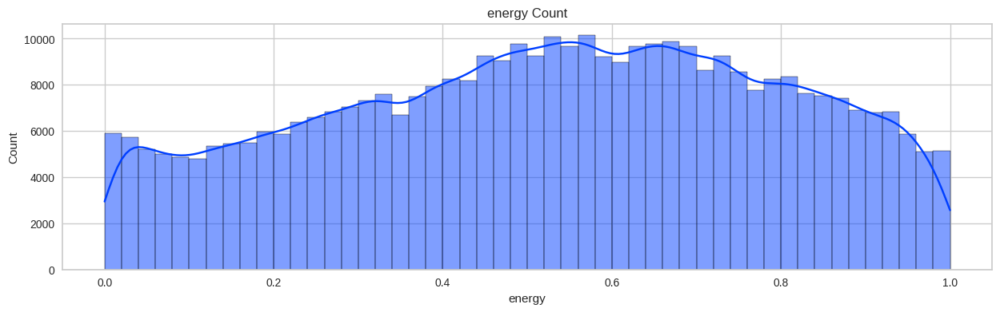

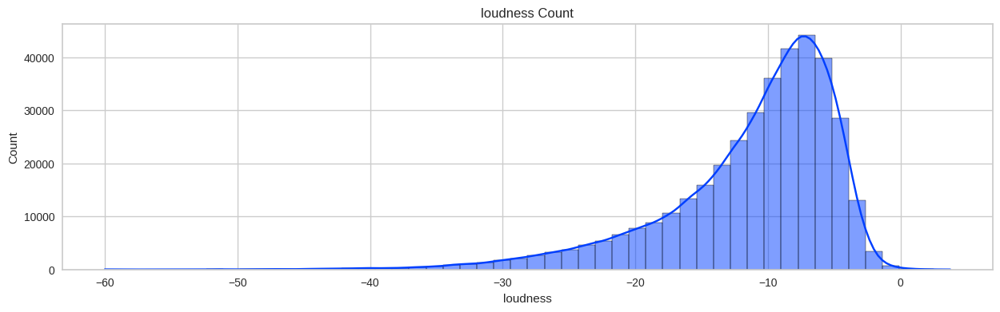

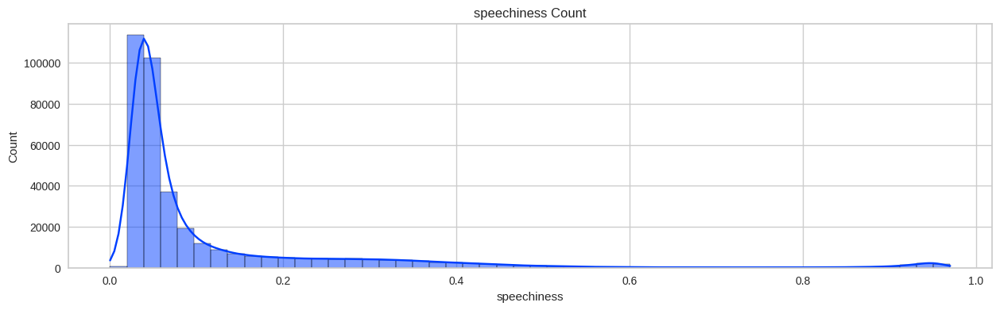

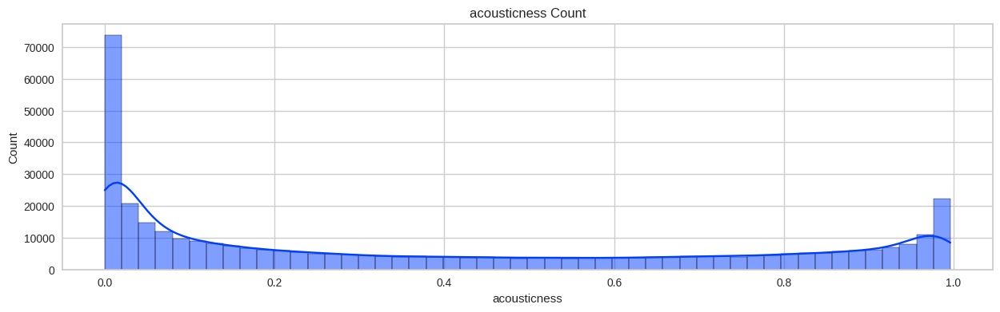

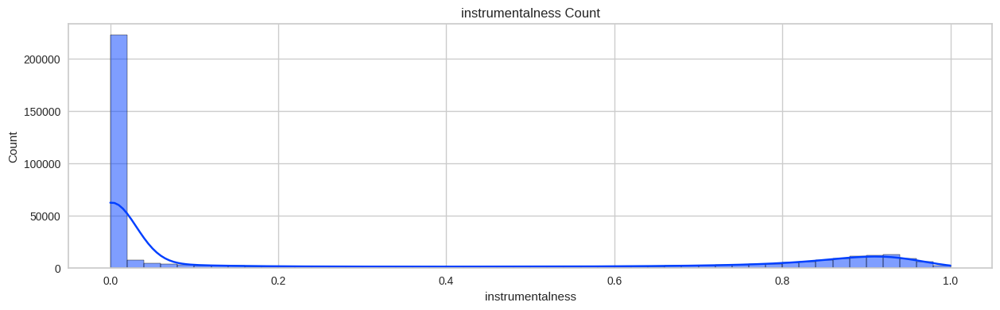

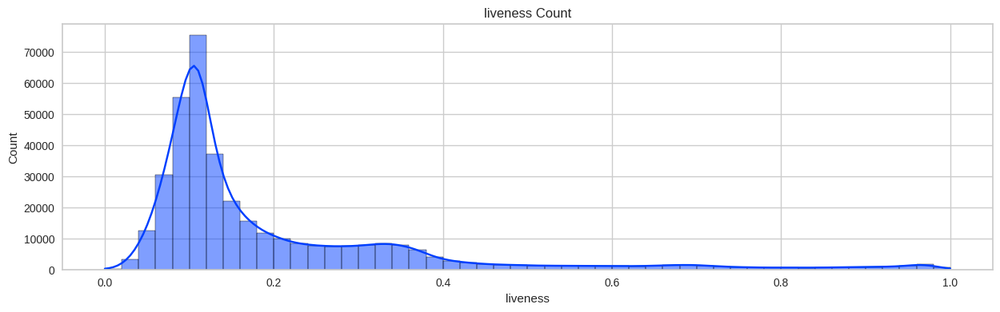

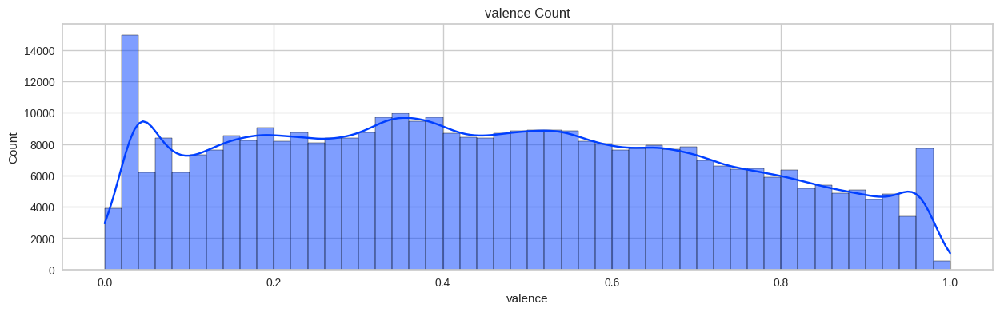

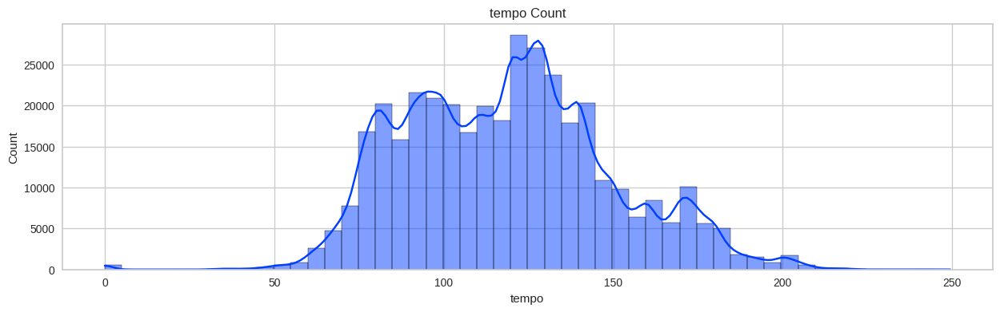

In [16]:
# Histogram Analysis of Continuous Variables
for i in df.drop(['explicit', 'key', 'mode', 'time_signature', 'name', 'artists', 'album_name', 'artist_genres', 'artist_genres_encoded'],axis=1):
    fig, ax = plt.subplots(figsize=(15, 4))
    fig = sns.histplot(data=df, x=i, bins=50, kde=True)
    fig.set_title(f'{i} Count')
    fig.grid(True)
    plt.show()


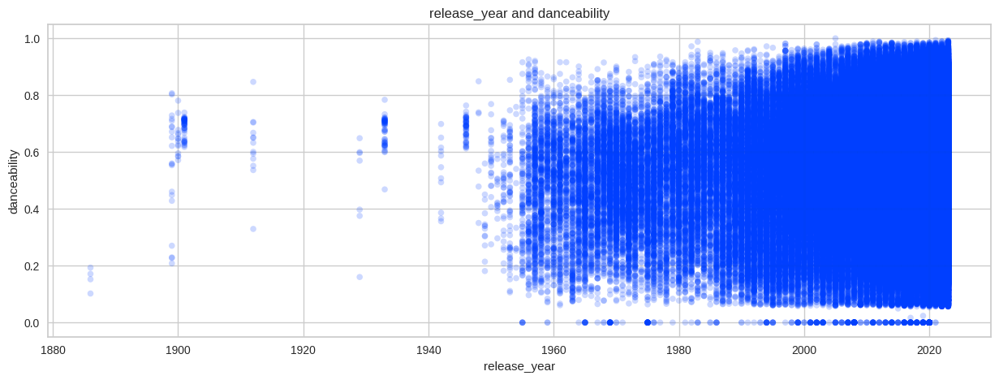

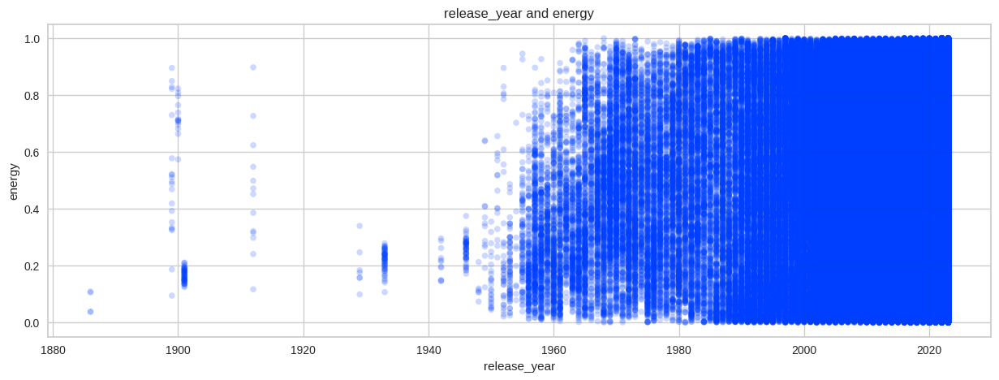

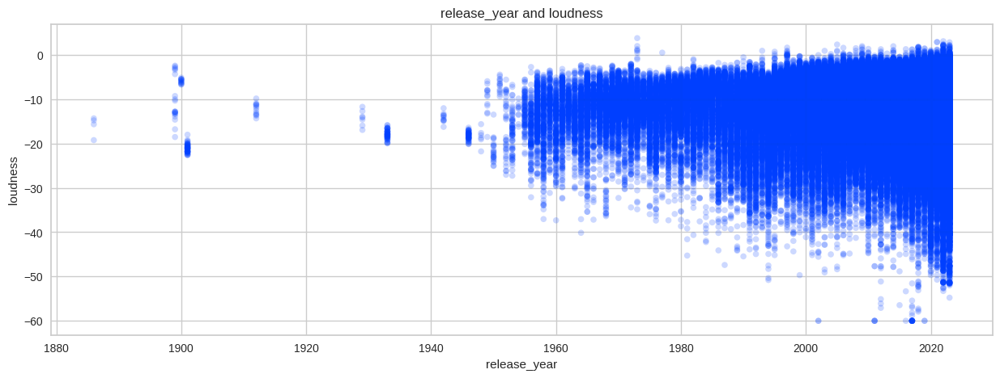

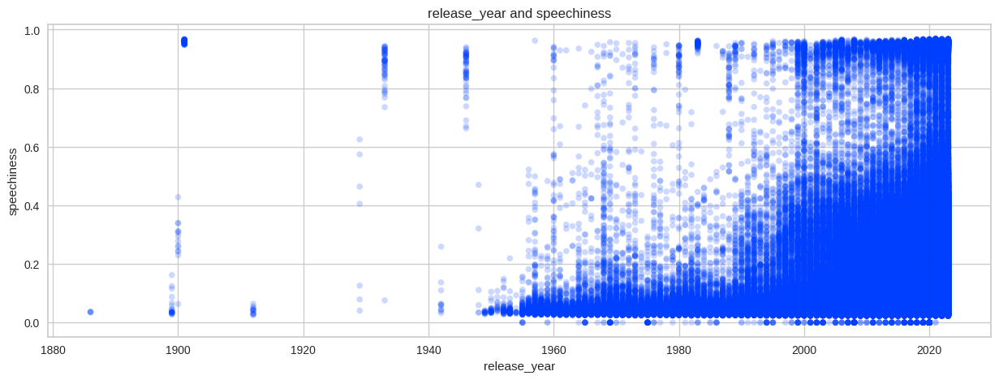

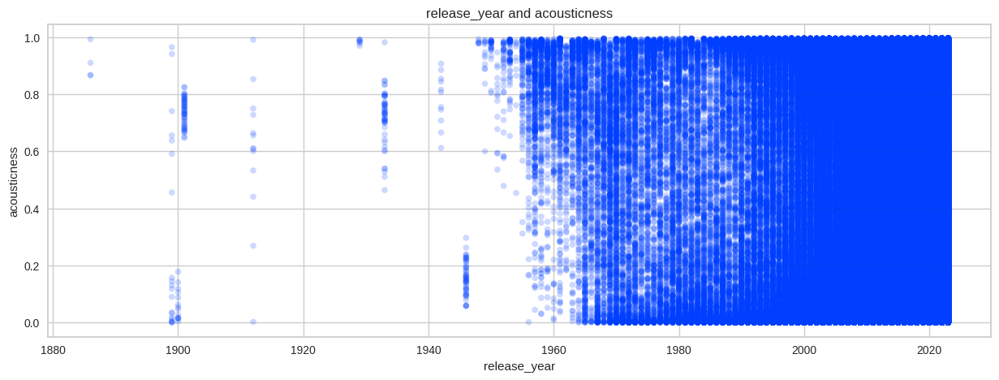

...

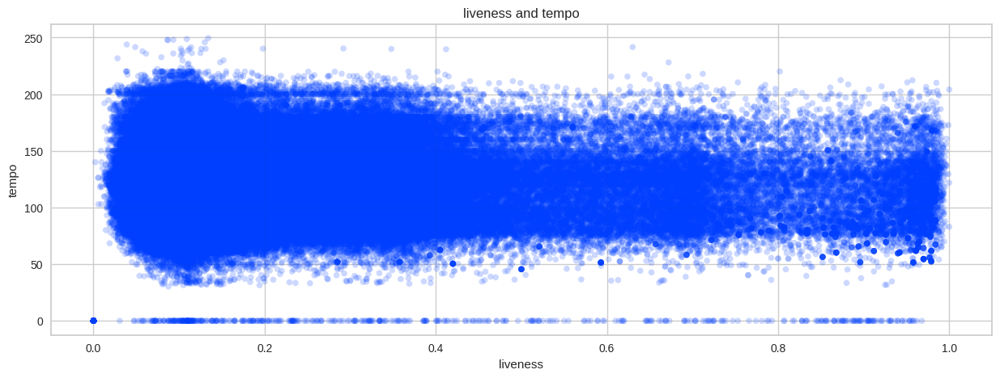

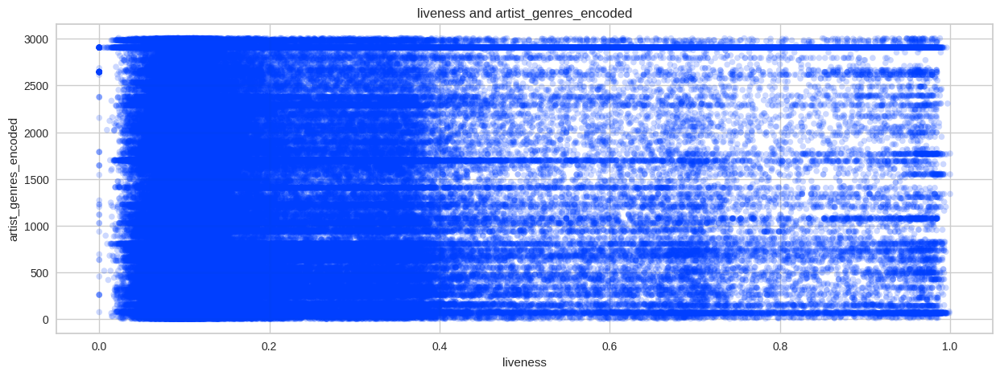

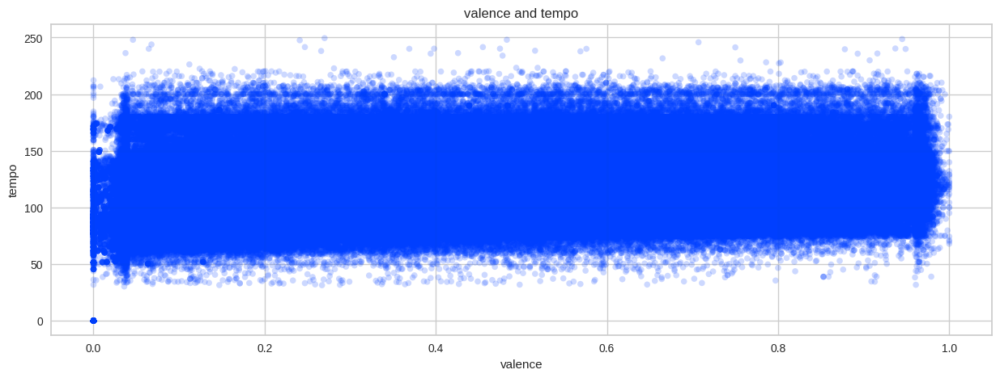

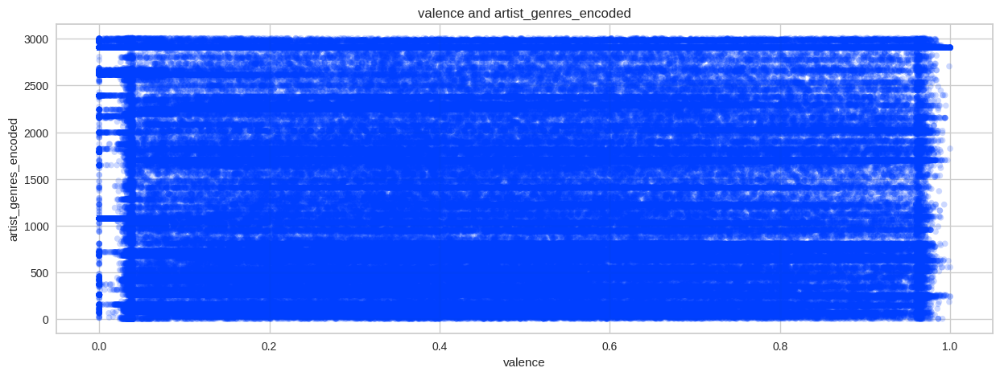

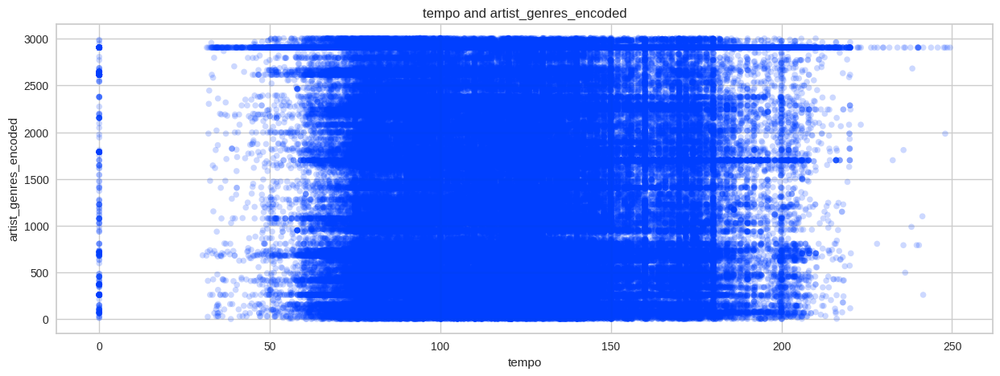

In [17]:
# Pairwise Scatter Plot Analysis of Music Attributes
from itertools import combinations
import matplotlib.patches as mpatches

for i, j in combinations(['release_year', 'danceability', 'energy', 'loudness', 'speechiness', 'acousticness', 'instrumentalness', 'liveness', 'valence', 'tempo', 'artist_genres_encoded'], 2):
    fig, ax = plt.subplots(figsize=(15, 5))
    plt.scatter(df[i],df[j], alpha=0.2, s=30, edgecolor="none")
    plt.xlabel(i)
    plt.ylabel(j)
    plt.title(f'{i} and {j}')
    plt.grid(True)
    plt.show()

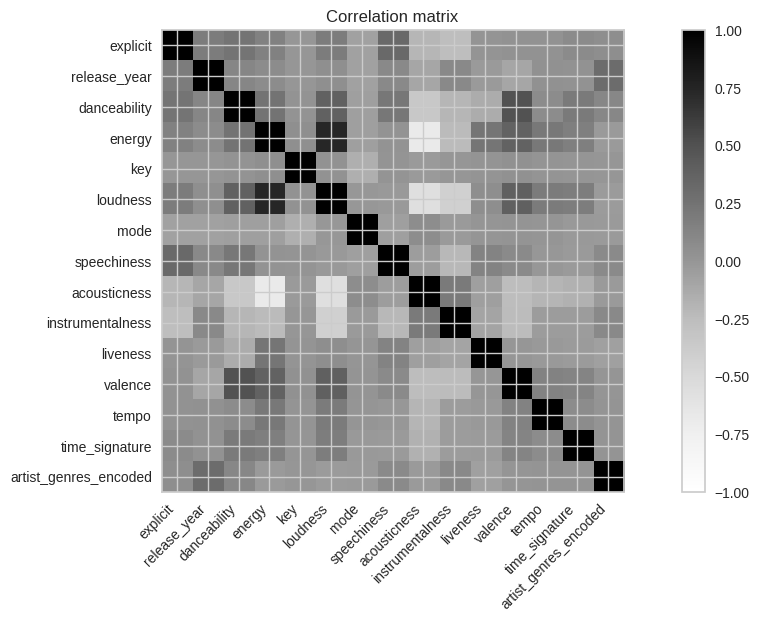

In [18]:
# Correlation matrix
plt.figure(figsize=(15,6))
plt.imshow(df[df.select_dtypes(np.number).columns].corr(), vmin=-1, vmax=1)
plt.xticks(range(len(df.select_dtypes(np.number).columns)), df.select_dtypes(np.number).columns, rotation=45, ha='right')
plt.yticks(range(len(df.select_dtypes(np.number).columns)), df.select_dtypes(np.number).columns)
plt.title('Correlation matrix')
plt.grid(True)
plt.colorbar()

plt.show()

# Pre Processing

In [19]:
# Selecting training features (numerate columns)
features = df.select_dtypes(np.number).columns

# Rescaling data using Standard Scaler
scaler = StandardScaler()
df_scaled = scaler.fit_transform(df[features])

df_scaled = pd.DataFrame(df_scaled, columns=features)

df_scaled.head()


,explicit,release_year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,artist_genres_encoded
0,2.326586,0.812444,0.260292,0.110499,-0.064324,0.266343,-1.327538,1.825873,-0.989181,-0.697217,1.115802,-0.270155,-1.510814,0.241707,0.893705
1,2.326586,0.812444,1.711935,0.666962,1.610970,0.773814,-1.327538,0.131448,-1.042932,-0.697221,-0.249621,-0.979750,-0.559366,0.241707,0.893705
2,2.326586,0.812444,1.098786,0.723744,1.331754,0.451128,-1.327538,1.629418,-0.847144,-0.697221,-0.403874,1.430620,-0.618088,0.241707,0.893705
3,2.326586,0.812444,1.947762,0.216492,-1.181186,0.312157,0.753274,1.107584,-1.062622,-0.697221,-0.574695,-0.758236,-0.447001,0.241707,0.893705
4,2.326586,0.812444,-0.237564,0.439834,-0.064324,0.011615,-1.327538,3.765866,-1.038197,-0.697221,-0.627255,-0.277664,1.771887,0.241707,0.893705


# Clustering

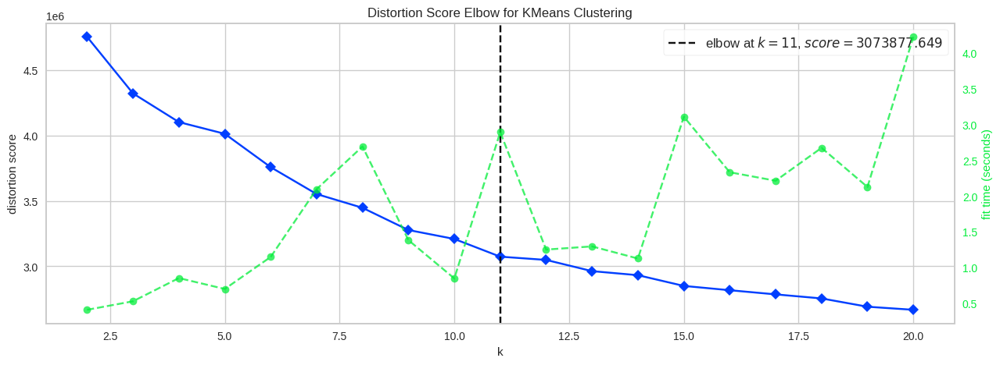

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [20]:
# Clustering

# Elbow Method to determine the number of clusters to be formed
plt.figure(figsize=(15,5))
Elbow_M = KElbowVisualizer(KMeans(n_init='auto'), k=20)
Elbow_M.fit(df_scaled)
Elbow_M.show()

In [21]:
# Using KMeans model 11 clusters
model = KMeans(n_clusters=11, n_init='auto')
model.fit(df_scaled)
df_scaled["Cluster"] = model.labels_


In [22]:
# Visualizing the Clusters with PCA
pca = PCA(n_components=2)
embedding = pca.fit_transform(df_scaled)
projection = pd.DataFrame(columns=['x', 'y'], data=embedding)
projection['title'] = df['name']
projection['genre'] = df['artist_genres']
projection['cluster'] = df_scaled['Cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genre'])
fig.show()


# Setting up Recommendation System

In [23]:
# Setting up Recommendation System

# Re-adding string features (Name, Artist, Genre, Album)
df_scaled = df_scaled.join(df[df.drop(features, axis=1).columns])

# Re-adding Year feature
df_scaled['release_year'] = df['release_year']

df_scaled.head()




,explicit,release_year,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,artist_genres_encoded,Cluster,name,artists,artist_genres,album_name
0,2.326586,2023,0.260292,0.110499,-0.064324,0.266343,-1.327538,1.825873,-0.989181,-0.697217,1.115802,-0.270155,-1.510814,0.241707,0.893705,7,Intro,AB,unknown,Son Of Tabu
1,2.326586,2023,1.711935,0.666962,1.610970,0.773814,-1.327538,0.131448,-1.042932,-0.697221,-0.249621,-0.979750,-0.559366,0.241707,0.893705,7,Play It Cool,"AB, 22nd Jim",unknown,Son Of Tabu
2,2.326586,2023,1.098786,0.723744,1.331754,0.451128,-1.327538,1.629418,-0.847144,-0.697221,-0.403874,1.430620,-0.618088,0.241707,0.893705,7,3 Peat,"AB, Veeze",unknown,Son Of Tabu
3,2.326586,2023,1.947762,0.216492,-1.181186,0.312157,0.753274,1.107584,-1.062622,-0.697221,-0.574695,-0.758236,-0.447001,0.241707,0.893705,7,Affiliated,AB,unknown,Son Of Tabu
4,2.326586,2023,-0.237564,0.439834,-0.064324,0.011615,-1.327538,3.765866,-1.038197,-0.697221,-0.627255,-0.277664,1.771887,0.241707,0.893705,7,Springfield,AB,unknown,Son Of Tabu


In [24]:
# Using Spotipy

# Replace with your actual Spotify API credentials
client_id = "af589e660451438184e20e35de29702b"
client_secret = "a7126e3469514fcab5be79000be8cb6d"

# Setting up Spotipy
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id=client_id,
                                                           client_secret=client_secret))

# Defining function for finding song on Spotify
def find_song(name, artists):
    song_data = defaultdict()  # Setting up song dictionary

    song_results = sp.search(q= 'track: {} artist: {}'.format(name, artists), limit=1)  # Searching for song data using song and artist name
    if song_results['tracks']['items'] == []:
        return None

    artist_results = sp.search(q= 'track: {} artist: {}'.format(name, artists), type='artist', limit=1)  # Searching for artist data using song and artist name

    results = song_results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]  # Getting song audio features

    song_data['name'] = [name]
    song_data['release_year'] = [pd.to_datetime(results['album']['release_date']).year]
    song_data['explicit'] = [int(results['explicit'])]
    genres = artist_results['artists']['items'][0]['genres']
    if genres != []:
        song_data['artist_genres_encoded'] = [label_encoder.transform([genres[0]])]
    else:
        song_data['artist_genres_encoded'] = [label_encoder.transform(['unknown'])]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

# Selecting training features (numerate columns)
number_cols = df.select_dtypes(np.number).columns

In [25]:
def get_song_data(song, spotify_data):
    try:  # Try to find song in imported data
        song_data = spotify_data[(spotify_data['name'] == song['name'])
                                & (spotify_data['artists'] == song['artists'])].iloc[0]
        return song_data

    except IndexError:  # If song not found, it will be retrieved from Spotify
        return find_song(song['name'], song['artists'])


In [26]:
def get_mean_vector(song_list, spotify_data):
    song_vectors = []

    for song in song_list:
        song_data = get_song_data(song, spotify_data)  # Getting song data from user input
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))  # Returning Warning if song does not exist in Spotify
            continue
        song_vector = song_data[number_cols].values  # Getting audio features of the data
        song_vectors.append(song_vector)

    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)

In [27]:
def flatten_dict_list(dict_list):
    flattened_dict = defaultdict()

    # Assign keys for dictionary
    for key in dict_list[0].keys():
        flattened_dict[key] = []

    # Append data to the dictionary
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)

    return flattened_dict


In [28]:
# Function to extract track ID from Spotify URL
def extract_track_id(url):
    return url.split("/")[-1].split("?")[0]


In [29]:
# Function to get song data from Spotify URL
def get_song_data_from_url(url):
    track_id = extract_track_id(url)
    track_data = sp.track(track_id)
    name = track_data['name']
    artists = ', '.join([artist['name'] for artist in track_data['artists']])
    return {'name': name, 'artists': artists}

In [30]:
# Modified recommend_songs function
def recommend_songs(song_list, spotify_data, n_songs=20):
    metadata_cols = ['name', 'artists', 'album_name', 'release_year', 'artist_genres']  # Features to be returned with recommendations

    # Applying pre-processing functions
    song_dict = flatten_dict_list(song_list)
    song_center = get_mean_vector(song_list, spotify_data)

    # Scaling data
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))

    # Computing distances
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs*2][0])  # Get more indices to filter for artist

    # Getting recommended songs from the dataset
    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]

    # Filter to ensure the first 5 recommendations are by the same artist
    target_artist = song_list[0]['artists']
    same_artist_recommendations = rec_songs[rec_songs['artists'].str.contains(target_artist)].head(5)
    other_recommendations = rec_songs[~rec_songs['artists'].str.contains(target_artist)]
    rec_songs = pd.concat([same_artist_recommendations, other_recommendations]).head(n_songs)

    # Convert recommendations to a dictionary
    rec_songs_dict = rec_songs[metadata_cols].to_dict(orient='records')

    # Get additional recommendations from Spotify
    spotify_recommendations = []
    for song in song_list:
        track_id = sp.search(q=f'track:{song["name"]} artist:{song["artists"]}', type='track', limit=1)
        if track_id['tracks']['items']:
            track_id = track_id['tracks']['items'][0]['id']
            rec_tracks = sp.recommendations(seed_tracks=[track_id], limit=n_songs)['tracks']
            for track in rec_tracks:
                name = track['name']
                artists = ', '.join([artist['name'] for artist in track['artists']])
                album_name = track['album']['name']
                release_year = pd.to_datetime(track['album']['release_date']).year
                artist_genres = sp.artist(track['artists'][0]['id'])['genres']
                artist_genres = artist_genres[0] if artist_genres else "unknown"
                spotify_recommendations.append({
                    'name': name,
                    'artists': artists,
                    'album_name': album_name,
                    'release_year': release_year,
                    'artist_genres': artist_genres
                })

    # Combine dataset and Spotify recommendations
    combined_recommendations = rec_songs_dict + spotify_recommendations
    combined_recommendations = [dict(t) for t in {tuple(d.items()) for d in combined_recommendations}]
    combined_recommendations = sorted(combined_recommendations, key=lambda x: x['release_year'], reverse=True)[:n_songs]

    return combined_recommendations

In [31]:
# Example: Asking for recommendations based on a Spotify URL
song_url = "https://open.spotify.com/track/5XeFesFbtLpXzIVDNQP22n?si=64d49bd4a58c446d"  # Example URL
song_data = get_song_data_from_url(song_url)
recommendations = recommend_songs([song_data], df_scaled)
print(song_data)

pd.DataFrame(recommendations)

{'name': 'I Wanna Be Yours', 'artists': 'Arctic Monkeys'}


,name,artists,album_name,release_year,artist_genres
0,CHIHIRO,Billie Eilish,HIT ME HARD AND SOFT,2024,art pop
1,WILDFLOWER,Billie Eilish,HIT ME HARD AND SOFT,2024,art pop
2,i like the way you kiss me,Artemas,yustyna,2024,unknown
3,Stargazing,Myles Smith,Stargazing,2024,singer-songwriter pop
4,Simply Wonderful,"BlackSkin Soundtrack, ""Mike DeCole""",Blackskin Motion Picture Soundtrack,2023,unknown
5,Amazing Grace,"OGIS, Saved Boy",Amazing Grace,2023,unknown
6,Wóz,"archie, dupaszatana",Sweet Chillin,2023,unknown
7,Closure (Feat. H.E.R.),"Chris Brown, H.E.R.",Breezy,2022,r&b
8,Bad Decisions (With Bts & Snoop Dogg) - Acoustic,"benny blanco, BTS, Snoop Dogg",Bad Decisions (With Bts & Snoop Dogg) [Acoustic],2022,pop
9,Closure (Feat. H.E.R.),"Chris Brown, H.E.R.",Breezy (Deluxe),2022,r&b


In [32]:
df_scaled.to_csv('/content/drive/MyDrive/Projects/Spotify recommendation System/spotify_data_scaled.csv', index=False)

In [33]:
import pickle

# Saving the scaler
with open('scaler.pkl', 'wb') as f:
    pickle.dump(scaler, f)

# Saving the KMeans model
with open('kmeans_model.pkl', 'wb') as f:
    pickle.dump(model, f)

# Saving the label encoder
with open('label_encoder.pkl', 'wb') as f:
    pickle.dump(label_encoder, f)


In [34]:
!pip install streamlit

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.7/8.7 MB 71.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 16.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.9/6.9 MB 106.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.0/83.0 kB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 5.4 MB/s eta 0:00:00
  Attempting uninstall: tenacity
    Found existing installation: tenacity 9.0.0
    Uninstalling tenacity-9.0.0:
      Successfully uninstalled tenacity-9.0.0
